## Week 5 Final Project - Find the best location to open a new Caffehouse in Sydney

#### Before we get the data and start exploring it, let's download all the dependencies that we will need.

In [80]:
!pip install geocoder

In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

!conda install -c conda-forge geopy --yes
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values
import geocoder # to get coordinates
import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors
# import k-means from clustering stage
from sklearn.cluster import KMeans

!conda install -c conda-forge folium=0.5.0 --yes 
import folium # map rendering library

print('Libraries imported.')

Solving environment: ...working... done

# All requested packages already installed.

Solving environment: ...working... done

# All requested packages already installed.

Libraries imported.


##### First we need to get the dataset of all suburbs in sydney with postcodes.This can be done using web scraping 

In [2]:
url='https://www.intosydneydirectory.com.au/sydney-postcodes.php'
df_list= pd.read_html(url)

In [3]:
df_list[1].head() #2st list of the webiste is for project purpose

,0,1,2
0,Abbotsbury,NSW,2176
1,Abbotsford,NSW,2046
2,Agnes Banks,NSW,2753
3,Airds,NSW,2560
4,Alexandria,NSW,2015


##### Define a new dataframe that includes the dataset of sydney suburbs with postcode

In [ ]:
sydney_data=df_list[1]

In [5]:
sydney_data.rename(columns={0:'Neighborhood',1:'State',2:'Postcode'},inplace=True)
print(sydney_data.shape)
sydney_data.head(5)

(689, 3)


,Neighborhood,State,Postcode
0,Abbotsbury,NSW,2176
1,Abbotsford,NSW,2046
2,Agnes Banks,NSW,2753
3,Airds,NSW,2560
4,Alexandria,NSW,2015


#### Here State column is not of interest so that column can be dropped.

In [6]:
sydney_data.drop(['State'], axis=1,inplace=True)


In [7]:
sydney_data.head(5)

,Neighborhood,Postcode
0,Abbotsbury,2176
1,Abbotsford,2046
2,Agnes Banks,2753
3,Airds,2560
4,Alexandria,2015


In [8]:
print(sydney_data.shape)
type(sydney_data)

(689, 2)


pandas.core.frame.DataFrame

In [9]:
# define a function to get coordinates
def get_latlng(neighborhood):
    # initialize your variable to None
    lat_lng_coords = None
    # loop until you get the coordinates
    while(lat_lng_coords is None):
        g = geocoder.arcgis('{}, Sydney, Australia'.format(neighborhood))
        lat_lng_coords = g.latlng
    return lat_lng_coords

In [10]:
# call the function to get the coordinates, store in a new list using list comprehension
coords = [ get_latlng(neighborhood) for neighborhood in sydney_data["Neighborhood"].tolist() ]

In [11]:
coords

[[-33.87284999999997, 150.8672100000001],
 [-33.850409999999954, 151.12846000000002],
 [-33.61444999999998, 150.7108300000001],
 [-34.08446999999995, 150.82904000000008],
 [-33.91236999999995, 151.19703000000004],
 [-33.99347999999998, 151.02471000000003],
 [-33.76560999999998, 151.25159000000008],
 [-33.97025999999994, 151.1160000000001],
 [-34.08386999999993, 150.80243000000007],
 [-33.88004999999998, 151.1713000000001],
 [-33.68130955409571, 150.97981582564793],
 [-34.08473963708334, 150.806658540858],
 [-33.88252243196826, 151.00448659162362],
 [-33.93664999999993, 151.14679],
 [-33.78836999999993, 150.87983000000008],
 [-33.80813999999998, 151.18380000000002],
 [-33.898169999999936, 151.1210000000001],
 [-33.916049999999984, 150.90111000000002],
 [-33.88919999999996, 151.12543000000005],
 [-33.68870999999996, 151.1094700000001],
 [-33.84847999999994, 151.02951000000007],
 [-33.897596293986226, 151.15457075339873],
 [-33.92683509099993, 150.80831086900002],
 [-33.63585999999998, 15

In [12]:
# create temporary dataframe to populate the coordinates into Latitude and Longitude
sydney_coords = pd.DataFrame(coords, columns=['Latitude', 'Longitude'])

In [13]:
sydney_coords.head()

,Latitude,Longitude
0,-33.87285,150.86721
1,-33.85041,151.12846
2,-33.61445,150.71083
3,-34.08447,150.82904
4,-33.91237,151.19703


In [14]:
# merge the coordinates into the original dataframe
sydney_data['Latitude'] = sydney_coords['Latitude']
sydney_data['Longitude'] = sydney_coords['Longitude']

In [15]:
# check the neighborhoods and the coordinates
print(sydney_data.shape)
sydney_data.head(14)

(689, 4)


,Neighborhood,Postcode,Latitude,Longitude
0,Abbotsbury,2176,-33.872850,150.867210
1,Abbotsford,2046,-33.850410,151.128460
2,Agnes Banks,2753,-33.614450,150.710830
3,Airds,2560,-34.084470,150.829040
4,Alexandria,2015,-33.912370,151.197030
5,Alfords Point,2234,-33.993480,151.024710
6,Allambie Heights,2100,-33.765610,151.251590
7,Allawah,2218,-33.970260,151.116000
8,Ambarvale,2560,-34.083870,150.802430
9,Annandale,2038,-33.880050,151.171300


In [16]:
sydney_data.dropna(inplace=True)

In [17]:
sydney_data.shape

(689, 4)

## Use geopy library to get the latitude and longitude values of Sydney.

In [18]:

address = 'Sydney, Australia'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinates of Sydney are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of Sydney are -33.8548157, 151.2164539.


### Generate map of Sydney using latitude and longitude values to visualize the neighborhoods 

In [19]:

map_sydney   = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, neighborhood in zip(sydney_data['Latitude'], sydney_data['Longitude'], sydney_data['Neighborhood']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_sydney)  
    
map_sydney

# Explore Sydney neighborhood  with Foursquare API

# FourSquare Credentials

In [20]:
CLIENT_ID = 'JN2IPHKRYJUOTBLRPCIQOSP3EDUWPB2SIYCIM3K5SCMBDARC'
CLIENT_SECRET = 'DNL2TSMRDDA2RYZKHXHA2FVFFFM3MRR0PLSNX4M43ADLYJPG'
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: JN2IPHKRYJUOTBLRPCIQOSP3EDUWPB2SIYCIM3K5SCMBDARC
CLIENT_SECRET:DNL2TSMRDDA2RYZKHXHA2FVFFFM3MRR0PLSNX4M43ADLYJPG


### Let's explore the first neighborhood in our dataframe.
###### Get the neighborhood's name.

In [21]:
sydney_data.loc[0, 'Neighborhood']

'Abbotsbury'

#### Get the neighborhood's latitude and longitude values.

In [22]:
neighborhood_latitude = sydney_data.loc[0, 'Latitude'] # neighborhood latitude value
neighborhood_longitude = sydney_data.loc[0, 'Longitude'] # neighborhood longitude value

neighborhood_name = sydney_data.loc[0, 'Neighborhood'] # neighborhood name

print('Latitude and longitude values of {} are {}, {}.'.format(neighborhood_name, 
                                                               neighborhood_latitude, 
                                                               neighborhood_longitude))

Latitude and longitude values of Abbotsbury are -33.87284999999997, 150.8672100000001.


### Now, let's get the top 10 venues that are in Abbotsbury within a radius of 500 meters.

#### First, let's create the GET request URL.

In [23]:
LIMIT=10
radius=500

url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    neighborhood_latitude, 
    neighborhood_longitude, 
    radius, 
    LIMIT)
url



'https://api.foursquare.com/v2/venues/explore?&client_id=JN2IPHKRYJUOTBLRPCIQOSP3EDUWPB2SIYCIM3K5SCMBDARC&client_secret=DNL2TSMRDDA2RYZKHXHA2FVFFFM3MRR0PLSNX4M43ADLYJPG&v=20180605&ll=-33.87284999999997,150.8672100000001&radius=500&limit=10'

### Send the GET request and examine the resutls

In [24]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5f16510bf5887b50516d0afa'},
 'response': {'warning': {'text': "There aren't a lot of results near you. Try something more general, reset your filters, or expand the search area."},
  'headerLocation': 'Current map view',
  'headerFullLocation': 'Current map view',
  'headerLocationGranularity': 'unknown',
  'totalResults': 3,
  'suggestedBounds': {'ne': {'lat': -33.86834999549997,
    'lng': 150.87261976718878},
   'sw': {'lat': -33.877350004499974, 'lng': 150.86180023281145}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4b84b81af964a5202f4231e3',
       'name': 'Stockdale Reserve',
       'location': {'lat': -33.871098,
        'lng': 150.86806,
        'labeledLatLngs': [{'label': 'display',
          'lat': -33.871098,
        

In [25]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [26]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head()

C:\Users\sapna\anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  This is separate from the ipykernel package so we can avoid doing imports until


,name,categories,lat,lng
0,Stockdale Reserve,Park,-33.871098,150.868060
1,Abbotsbury Shops,Convenience Store,-33.869554,150.865294
2,817 bus stop,Bus Stop,-33.869773,150.870122


In [27]:
nearby_venues

,name,categories,lat,lng
0,Stockdale Reserve,Park,-33.871098,150.868060
1,Abbotsbury Shops,Convenience Store,-33.869554,150.865294
2,817 bus stop,Bus Stop,-33.869773,150.870122


In [28]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

3 venues were returned by Foursquare.


In [29]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        #print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            100)
             # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])
        nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    print('Found {} venues in {} neighborhoods.'.format(nearby_venues.shape[0], len(venues_list)))
    
    return(nearby_venues)
            
        
 

In [30]:
#to get the total number of venues available in sydney
sydney_venues = getNearbyVenues(names=sydney_data['Neighborhood'],
                                   latitudes=sydney_data['Latitude'],
                                   longitudes=sydney_data['Longitude']
                                  )

Found 8802 venues in 689 neighborhoods.


In [31]:
print(sydney_venues.shape)
sydney_venues.head(20)

(8802, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbotsbury,-33.87285,150.86721,Stockdale Reserve,-33.871098,150.868060,Park
1,Abbotsbury,-33.87285,150.86721,Abbotsbury Shops,-33.869554,150.865294,Convenience Store
2,Abbotsbury,-33.87285,150.86721,817 bus stop,-33.869773,150.870122,Bus Stop
3,Abbotsford,-33.85041,151.12846,The Cove Dining Co,-33.850933,151.129015,Café
4,Abbotsford,-33.85041,151.12846,The Cove Dining Co,-33.850950,151.129110,Café
5,Abbotsford,-33.85041,151.12846,Henry Lawson Park,-33.850350,151.125895,Park
6,Abbotsford,-33.85041,151.12846,Sistina Ristorante & Pizzeria,-33.848149,151.128307,Pizza Place
7,Abbotsford,-33.85041,151.12846,Lock Stock And Bottle,-33.847860,151.127970,Wine Shop
8,Abbotsford,-33.85041,151.12846,sog,-33.847730,151.127950,Asian Restaurant
9,Abbotsford,-33.85041,151.12846,Cinnamon Thai Cuisine,-33.847697,151.128288,Thai Restaurant


###### There are total 8802 venues in 689 venues.

In [32]:
sydney_venues

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Abbotsbury,-33.872850,150.867210,Stockdale Reserve,-33.871098,150.868060,Park
1,Abbotsbury,-33.872850,150.867210,Abbotsbury Shops,-33.869554,150.865294,Convenience Store
2,Abbotsbury,-33.872850,150.867210,817 bus stop,-33.869773,150.870122,Bus Stop
3,Abbotsford,-33.850410,151.128460,The Cove Dining Co,-33.850933,151.129015,Café
4,Abbotsford,-33.850410,151.128460,The Cove Dining Co,-33.850950,151.129110,Café
5,Abbotsford,-33.850410,151.128460,Henry Lawson Park,-33.850350,151.125895,Park
6,Abbotsford,-33.850410,151.128460,Sistina Ristorante & Pizzeria,-33.848149,151.128307,Pizza Place
7,Abbotsford,-33.850410,151.128460,Lock Stock And Bottle,-33.847860,151.127970,Wine Shop
8,Abbotsford,-33.850410,151.128460,sog,-33.847730,151.127950,Asian Restaurant
9,Abbotsford,-33.850410,151.128460,Cinnamon Thai Cuisine,-33.847697,151.128288,Thai Restaurant


### Let's check how many venues were returned for each neighborhood

In [33]:
sydney_venues.groupby('Neighborhood').count()


,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Abbotsbury,3,3,3,3,3,3
Abbotsford,7,7,7,7,7,7
Airds,4,4,4,4,4,4
Alexandria,27,27,27,27,27,27
Alfords Point,3,3,3,3,3,3
Allambie Heights,6,6,6,6,6,6
Allawah,2,2,2,2,2,2
Ambarvale,7,7,7,7,7,7
Annandale,26,26,26,26,26,26


#### Let's find out how many unique categories can be curated from all the returned venues

In [34]:
print('There are {} uniques categories.'.format(len(sydney_venues['Venue Category'].unique())))

There are 369 uniques categories.


# Analyze Each Neighborhood

In [35]:
#one hot encoding
sydney_onehot = pd.get_dummies(sydney_venues[['Venue Category']], prefix="", prefix_sep="")

#add neighborhood column back to dataframe
sydney_onehot['Neighborhood'] = sydney_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [sydney_onehot.columns[-1]] + list(sydney_onehot.columns[:-1])
sydney_onehot = sydney_onehot[fixed_columns]

sydney_onehot.head()

,Yoga Studio,ATM,Accessories Store,Advertising Agency,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,American Restaurant,Arcade,Arepa Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bathing Area,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boat Rental,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Bowling Green,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cambodian Restaurant,Campground,Candy Store,Cantonese Restaurant,Car Wash,Carpet Store,Cha Chaan Teng,Chaat Place,Child Care Service,Chinese Restaurant,Chocolate Shop,Churrascaria,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Rec Center,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Creperie,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Dive Shop,Dog Run,Donut Shop,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Entertainment Service,Event Space,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Financial or Legal Service,Fish & Chips Shop,Fish Market,Fishing Spot,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,German Restaurant,Gift Shop,Go Kart Track,Golf Course,Gourmet Shop,Government Building,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,Hungarian Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indonesian Meatball Place,Indonesian Restaurant,Indoor Play Area,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Light Rail Station,Lighthouse,Lighting Store,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Modern Greek Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Motorsports Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Neighborhood,Newsstand,Nightclub,Noodle House,Office,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Store,Paintball Field,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Poke Place,Pool,Portuguese Restaurant,Post O

### And let's examine the new dataframe size.

In [36]:
sydney_onehot.shape

(8802, 369)

##### Next, let's group rows by neighborhood and by taking the mean of the frequency of occurrence of each category

In [37]:
sydney_grouped = sydney_onehot.groupby('Neighborhood').mean().reset_index()
sydney_grouped

,Neighborhood,Yoga Studio,ATM,Accessories Store,Advertising Agency,Afghan Restaurant,African Restaurant,Airport,Airport Lounge,Airport Service,American Restaurant,Arcade,Arepa Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Australian Restaurant,Austrian Restaurant,Auto Dealership,Auto Garage,Auto Workshop,BBQ Joint,Baby Store,Bagel Shop,Bakery,Bar,Baseball Field,Basketball Court,Basketball Stadium,Bathing Area,Bay,Beach,Beach Bar,Bed & Breakfast,Beer Bar,Beer Garden,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Trail,Bistro,Board Shop,Boat Rental,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Bowling Green,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bridge,Bubble Tea Shop,Buffet,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cambodian Restaurant,Campground,Candy Store,Cantonese Restaurant,Car Wash,Carpet Store,Cha Chaan Teng,Chaat Place,Child Care Service,Chinese Restaurant,Chocolate Shop,Churrascaria,Circus,Climbing Gym,Clothing Store,Cocktail Bar,Coffee Roaster,Coffee Shop,College Cafeteria,College Rec Center,Colombian Restaurant,Comedy Club,Comfort Food Restaurant,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Costume Shop,Creperie,Cricket Ground,Cruise,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Dentist's Office,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Dive Bar,Dive Shop,Dog Run,Donut Shop,Dumpling Restaurant,Duty-free Shop,Eastern European Restaurant,Egyptian Restaurant,Electronics Store,Entertainment Service,Event Space,Falafel Restaurant,Farm,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Financial or Legal Service,Fish & Chips Shop,Fish Market,Fishing Spot,Fishing Store,Flea Market,Flower Shop,Food,Food & Drink Shop,Food Court,Food Stand,Food Truck,Football Stadium,Forest,Fountain,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,General College & University,General Entertainment,German Restaurant,Gift Shop,Go Kart Track,Golf Course,Gourmet Shop,Government Building,Greek Restaurant,Grilled Meat Restaurant,Grocery Store,Gym,Gym / Fitness Center,Gym Pool,Gymnastics Gym,Harbor / Marina,Hawaiian Restaurant,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Field,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Hotpot Restaurant,Hunan Restaurant,Hungarian Restaurant,IT Services,Ice Cream Shop,Indian Chinese Restaurant,Indian Restaurant,Indie Movie Theater,Indonesian Meatball Place,Indonesian Restaurant,Indoor Play Area,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kebab Restaurant,Kids Store,Kitchen Supply Store,Korean Restaurant,Kosher Restaurant,Lake,Latin American Restaurant,Lebanese Restaurant,Library,Light Rail Station,Lighthouse,Lighting Store,Lingerie Store,Liquor Store,Lounge,Malay Restaurant,Market,Martial Arts Dojo,Massage Studio,Mattress Store,Mediterranean Restaurant,Memorial Site,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Mini Golf,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Modern Greek Restaurant,Monument / Landmark,Moroccan Restaurant,Motel,Motorcycle Shop,Motorsports Shop,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,National Park,Nature Preserve,Newsstand,Nightclub,Noodle House,Office,Optical Shop,Organic Grocery,Other Great Outdoors,Other Nightlife,Other Repair Shop,Outdoor Supply Store,Outdoors & Recreation,Outlet Store,Paintball Field,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Pedestrian Plaza,Performing Arts Venue,Persian Restaurant,Pet Store,Pharmacy,Photography Studio,Pie Shop,Pier,Pizza Place,Planetarium,Platform,Playground,Plaza,Poke Place,Pool,Portuguese Restaurant,Post O

##### Let's confirm the new size

In [38]:
sydney_grouped.shape

(628, 369)

## Let's print each neighborhood along with the top 5 most common venues

In [39]:
num_top_venues = 5

for hood in sydney_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = sydney_grouped[sydney_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Abbotsbury----
               venue  freq
0  Convenience Store  0.33
1               Park  0.33
2           Bus Stop  0.33
3        Yoga Studio  0.00
4             Office  0.00


----Abbotsford----
             venue  freq
0             Café  0.29
1        Wine Shop  0.14
2             Park  0.14
3  Thai Restaurant  0.14
4      Pizza Place  0.14


----Airds----
           venue  freq
0            Pub  0.25
1  Shopping Mall  0.25
2    Pizza Place  0.25
3    Gas Station  0.25
4      Nightclub  0.00


----Alexandria----
                 venue  freq
0                 Café  0.22
1       Sandwich Place  0.04
2  Lebanese Restaurant  0.04
3      Thai Restaurant  0.04
4                  Gym  0.04


----Alfords Point----
           venue  freq
0     Playground  0.33
1  Shopping Mall  0.33
2    Flea Market  0.33
3    Yoga Studio  0.00
4      Nightclub  0.00


----Allambie Heights----
           venue  freq
0           Café  0.33
1  Grocery Store  0.17
2         Bakery  0.17
3   Liquor Store  

                   venue  freq
0                 Market   1.0
1            Yoga Studio   0.0
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4   Outdoor Supply Store   0.0


----Blacktown----
                  venue  freq
0  Fast Food Restaurant  0.12
1      Department Store  0.05
2             Juice Bar  0.05
3                  Café  0.05
4           Coffee Shop  0.05


----Blacktown Westpoint----
                  venue  freq
0  Fast Food Restaurant  0.12
1      Department Store  0.05
2             Juice Bar  0.05
3                  Café  0.05
4           Coffee Shop  0.05


----Blakehurst----
                 venue  freq
0  Sporting Goods Shop  0.33
1                 Park  0.33
2   Dim Sum Restaurant  0.33
3          Yoga Studio  0.00
4            Nightclub  0.00


----Blenheim Road----
                 venue  freq
0               Bakery  0.12
1  Japanese Restaurant  0.12
2                 Café  0.12
3        Train Station  0.12
4          Coffee Shop  0.12


----Bligh

                  venue  freq
0         Shopping Mall   0.5
1          Soccer Field   0.5
2           Yoga Studio   0.0
3             Nightclub   0.0
4  Outdoor Supply Store   0.0


----Clemton Park----
            venue  freq
0            Café  0.50
1     Supermarket  0.25
2  Shopping Plaza  0.25
3     Yoga Studio  0.00
4       Nightclub  0.00


----Clontarf----
               venue  freq
0  Indian Restaurant  0.15
1               Café  0.15
2             Bakery  0.08
3        Coffee Shop  0.08
4          Wine Shop  0.08


----Clovelly----
            venue  freq
0          Bakery  0.20
1            Café  0.20
2    Burger Joint  0.13
3           Hotel  0.07
4  Massage Studio  0.07


----Clyde----
                 venue  freq
0      Motorcycle Shop   0.2
1    Convenience Store   0.2
2            Racetrack   0.2
3  Rental Car Location   0.2
4        Train Station   0.2


----Colebee----
                   venue  freq
0           Home Service   0.5
1               Building   0.5
2       

           venue  freq
0           Café  0.18
1  Hot Dog Joint  0.09
2  Big Box Store  0.09
3           Food  0.09
4           Park  0.09


----Enmore----
                   venue  freq
0                   Café  0.07
1                    Bar  0.07
2  Vietnamese Restaurant  0.07
3                    Pub  0.05
4     Turkish Restaurant  0.05


----Epping----
                  venue  freq
0                   Gym  0.25
1           Bus Station  0.25
2          Liquor Store  0.25
3  Gym / Fitness Center  0.25
4                Museum  0.00


----Ermington----
                   venue  freq
0                 Bakery  0.08
1  Vietnamese Restaurant  0.08
2           Liquor Store  0.08
3     Seafood Restaurant  0.08
4   Fast Food Restaurant  0.08


----Erskineville----
             venue  freq
0             Café  0.25
1              Pub  0.17
2              Bar  0.17
3         Sake Bar  0.08
4  Motorcycle Shop  0.08


----Eschol Park----
               venue  freq
0        Sports Club  0.33
1      

4      Electronics Store  0.05


----Hurstville Grove----
                venue  freq
0       Grocery Store   0.2
1                Park   0.2
2  Italian Restaurant   0.2
3               Trail   0.2
4        Tennis Court   0.2


----Illawong----
                  venue  freq
0  Gym / Fitness Center   0.2
1     Convenience Store   0.2
2                  Café   0.2
3         Shopping Mall   0.2
4                Bakery   0.2


----Ingleside----
                   venue  freq
0            Golf Course   1.0
1            Yoga Studio   0.0
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4   Outdoor Supply Store   0.0


----Jamisontown----
                 venue  freq
0  Sporting Goods Shop  0.15
1                  Gym  0.15
2  Arts & Crafts Store  0.08
3         Skating Rink  0.08
4                  Bar  0.08


----Jannali----
                venue  freq
0              Bakery  0.15
1     Thai Restaurant  0.15
2       Grocery Store  0.15
3         Pizza Place  0.08
4  Seafood Rest

                   venue  freq
0                   Café  0.23
1  Vietnamese Restaurant  0.13
2          Deli / Bodega  0.06
3                    Bar  0.06
4                 Lounge  0.03


----Marsfield----
               venue  freq
0               Park   0.4
1  Martial Arts Dojo   0.2
2        Bus Station   0.2
3        Pizza Place   0.2
4        Yoga Studio   0.0


----Mascot----
                   venue  freq
0        Thai Restaurant  0.11
1                 Bakery  0.11
2            Coffee Shop  0.11
3  Indonesian Restaurant  0.06
4               Pharmacy  0.06


----Matraville----
               venue  freq
0             Bakery  0.29
1            Dog Run  0.14
2  Convenience Store  0.14
3        Supermarket  0.14
4        Gas Station  0.14


----Mays Hill----
                   venue  freq
0            Bus Station   0.2
1                   Park   0.2
2                 Museum   0.2
3  Australian Restaurant   0.2
4                 Tunnel   0.2


----Mcgraths Hill----
                

          venue  freq
0           Bay  0.33
1  Tennis Court  0.33
2          Pier  0.33
3   Yoga Studio  0.00
4  Noodle House  0.00


----Oakdale----
               venue  freq
0  Convenience Store  0.17
1               Park  0.17
2      Deli / Bodega  0.17
3       Dessert Shop  0.17
4      Grocery Store  0.17


----Oakhurst----
                  venue  freq
0  Fast Food Restaurant   0.2
1              Pharmacy   0.1
2         Shopping Mall   0.1
3        Sandwich Place   0.1
4     Electronics Store   0.1


----Oakville----
                    venue  freq
0                    Café  0.33
1            Liquor Store  0.17
2  Furniture / Home Store  0.17
3       Food & Drink Shop  0.17
4             Bus Station  0.17


----Oatlands----
           venue  freq
0  Grocery Store  0.25
1           Café  0.25
2    Bus Station  0.25
3   Home Service  0.25
4   Outlet Store  0.00


----Oatley----
                venue  freq
0  Italian Restaurant  0.29
1   French Restaurant  0.14
2  Chinese Restauran

                  venue  freq
0         Shopping Mall   0.4
1         Grocery Store   0.2
2  Fast Food Restaurant   0.2
3           Pizza Place   0.2
4          Noodle House   0.0


----Roseville----
                        venue  freq
0         Fried Chicken Joint  0.18
1                        Café  0.18
2                 Coffee Shop  0.09
3  Modern European Restaurant  0.09
4                         Bar  0.09


----Roseville Chase----
                 venue  freq
0            Wine Shop   0.2
1  Lebanese Restaurant   0.2
2      Thai Restaurant   0.2
3                Beach   0.2
4          Gas Station   0.2


----Rossmore----
                   venue  freq
0    Lebanese Restaurant  0.33
1   Pakistani Restaurant  0.17
2  Australian Restaurant  0.17
3   Fast Food Restaurant  0.17
4          Grocery Store  0.17


----Rouse Hill----
                   venue  freq
0        Paintball Field   0.5
1               Bus Stop   0.5
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4  

                   venue  freq
0                   Lake   1.0
1            Yoga Studio   0.0
2           Noodle House   0.0
3  Outdoors & Recreation   0.0
4   Outdoor Supply Store   0.0


----Wahroonga----
                 venue  freq
0                 Café  0.11
1      Thai Restaurant  0.11
2          Pizza Place  0.05
3   Chinese Restaurant  0.05
4  Fried Chicken Joint  0.05


----Waitara----
                 venue  freq
0      Thai Restaurant  0.14
1           Sports Bar  0.07
2  Rental Car Location  0.07
3          Sports Club  0.07
4    Food & Drink Shop  0.07


----Wakeley----
               venue  freq
0      Grocery Store  0.25
1  Convenience Store  0.25
2      Shopping Mall  0.25
3       Burger Joint  0.25
4             Office  0.00


----Wallacia----
                     venue  freq
0               Campground   0.2
1                Hotel Bar   0.2
2                     Lake   0.2
3  Health & Beauty Service   0.2
4                Rest Area   0.2


----Wareemba----
            

           venue  freq
0  Grocery Store  0.25
1      BBQ Joint  0.25
2         Arcade  0.25
3   Soccer Field  0.25
4    Yoga Studio  0.00


----Yagoona----
            venue  freq
0  Baseball Field  0.25
1            Park  0.25
2     Auto Garage  0.25
3     Pizza Place  0.25
4     Yoga Studio  0.00


----Yanderra----
                  venue  freq
0            Playground   1.0
1           Yoga Studio   0.0
2             Newsstand   0.0
3  Outdoor Supply Store   0.0
4     Other Repair Shop   0.0


----Yarrawarrah----
         venue  freq
0         Park  0.33
1  Pizza Place  0.33
2     Pharmacy  0.33
3  Yoga Studio  0.00
4    Nightclub  0.00


----Yennora----
                        venue  freq
0                    Platform  0.50
1  Construction & Landscaping  0.25
2               Train Station  0.25
3                 Yoga Studio  0.00
4                Noodle House  0.00


----Yowie Bay----
                   venue  freq
0                Brewery   1.0
1            Yoga Studio   0.0
2     

# Let's put that into a pandas dataframe
First, let's write a function to sort the venues in descending order.

In [40]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

####  Now let's create the new dataframe and display the top venue for each neighborhood.

In [43]:
num_top_venues = 1
indicators = ['st']

 #create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
      columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
sydney_venues_sorted = pd.DataFrame(columns=columns)
sydney_venues_sorted['Neighborhood'] = sydney_grouped['Neighborhood']

for ind in np.arange(sydney_grouped.shape[0]):
   sydney_venues_sorted.iloc[ind, 1:] = return_most_common_venues(sydney_grouped.iloc[ind, :], num_top_venues)

sydney_venues_sorted.head()

,Neighborhood,1st Most Common Venue
0,Abbotsbury,Convenience Store
1,Abbotsford,Café
2,Airds,Pub
3,Alexandria,Café
4,Alfords Point,Playground


## Cluster Neighborhoods
Run k-means to cluster the neighborhood into 3 clusters.

In [45]:
# set number of clusters
kclusters = 3

sydney_grouped_clustering = sydney_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(sydney_grouped_clustering)

# check cluster labels generated for each row in the dataframe
labels=kmeans.labels_
print(labels)

[2 1 0 1 0 1 0 0 1 0 0 0 2 1 0 0 0 0 1 2 1 1 0 1 2 1 1 1 0 0 0 1 1 0 0 2 1
 2 1 0 1 1 0 1 2 1 1 0 1 1 1 1 0 0 0 0 0 0 0 1 0 1 1 0 0 0 0 2 0 2 0 1 0 0
 0 1 0 0 0 0 1 1 0 1 1 0 0 0 1 1 0 0 0 2 0 1 1 1 0 1 0 1 0 0 0 0 1 0 1 0 0
 0 2 0 1 0 1 0 0 0 0 0 0 1 1 0 2 0 1 1 0 1 1 0 1 0 0 0 0 1 1 1 0 0 0 0 0 1
 1 1 2 1 0 1 1 0 0 0 1 0 0 0 1 1 2 1 2 0 0 2 2 1 1 0 1 0 0 0 0 1 0 0 0 1 1
 0 2 1 0 1 0 1 1 0 1 0 2 1 0 0 0 0 0 1 0 0 0 1 0 0 1 0 0 1 1 0 0 0 1 2 0 0
 1 0 0 1 0 1 0 1 0 1 2 0 1 0 1 0 2 0 0 0 0 2 0 0 0 0 0 0 0 1 1 1 1 0 0 0 1
 1 0 1 1 0 1 2 0 0 0 0 0 2 2 0 0 2 0 0 1 0 0 1 2 2 0 1 2 0 0 0 0 1 0 0 0 1
 0 0 0 0 1 1 1 1 1 0 0 0 1 0 0 1 1 2 1 2 1 1 0 2 0 0 1 0 0 0 1 0 1 0 0 1 2
 1 0 1 1 0 0 2 0 2 2 0 1 0 0 1 1 1 1 1 0 0 2 0 1 2 0 0 0 0 0 0 0 0 0 1 0 0
 2 0 1 1 1 1 0 0 0 0 1 0 0 0 1 0 1 1 1 0 2 0 1 0 0 0 1 1 0 0 0 0 0 1 1 1 0
 0 1 0 0 0 1 0 1 1 0 0 0 2 2 2 1 0 1 1 0 0 1 1 0 0 0 0 1 1 0 0 2 0 2 0 2 0
 1 1 1 1 0 0 0 1 2 0 0 0 0 0 1 1 1 0 0 2 0 0 2 0 0 1 0 0 0 0 1 0 0 1 1 0 1
 0 1 1 0 0 1 1 2 0 0 0 0 

In [46]:
#herefore, each row is assigned a label.
sydney_venues_sorted["Labels"] = labels
sydney_venues_sorted.head(5)

,Neighborhood,1st Most Common Venue,Labels
0,Abbotsbury,Convenience Store,2
1,Abbotsford,Café,1
2,Airds,Pub,0
3,Alexandria,Café,1
4,Alfords Point,Playground,0


## Let's create a new dataframe that includes the cluster as well as the top most visited venue for each neighborhood.

In [49]:
sydney_merged = sydney_data

# merge suburb_grouped with toronto_data to add latitude/longitude for each neighborhood
sydney_merged = sydney_merged.join(sydney_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

sydney_merged.head() 

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
0,Abbotsbury,2176,-33.87285,150.86721,Convenience Store,2.0
1,Abbotsford,2046,-33.85041,151.12846,Café,1.0
2,Agnes Banks,2753,-33.61445,150.71083,NaN,NaN
3,Airds,2560,-34.08447,150.82904,Pub,0.0
4,Alexandria,2015,-33.91237,151.19703,Café,1.0


In [50]:
sydney_merged.shape

(689, 6)

In [51]:
#For clustering drop NaN values
sydney_merged.dropna(inplace=True)

In [52]:
sydney_merged.shape

(628, 6)

# Finally, let's visualize the resulting clusters

In [53]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sydney_merged['Latitude'], sydney_merged['Longitude'], sydney_merged['Neighborhood'], sydney_merged['Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

# Cluster 1

In [54]:
cluster_1=sydney_merged.loc[sydney_merged['Labels'] == 0]

In [55]:
cluster_1

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
3,Airds,2560,-34.084470,150.829040,Pub,0.0
5,Alfords Point,2234,-33.993480,151.024710,Playground,0.0
7,Allawah,2218,-33.970260,151.116000,Pub,0.0
8,Ambarvale,2560,-34.083870,150.802430,Business Service,0.0
11,Appin,2560,-34.084740,150.806659,Business Service,0.0
12,Arcadia,2159,-33.882522,151.004487,Market,0.0
13,Arncliffe,2205,-33.936650,151.146790,Grocery Store,0.0
16,Ashbury,2193,-33.898170,151.121000,Other Repair Shop,0.0
18,Ashfield,2131,-33.889200,151.125430,Dumpling Restaurant,0.0
19,Asquith,2077,-33.688710,151.109470,Fast Food Restaurant,0.0


In [74]:
print(cluster_1.shape)

(352, 6)


In [77]:
cluster_1['1st Most Common Venue'].value_counts()


Café                             24
Fast Food Restaurant             23
Convenience Store                19
Pub                              15
Coffee Shop                      12
Grocery Store                    11
Supermarket                      10
Thai Restaurant                  10
Platform                          9
Pizza Place                       9
Lebanese Restaurant               9
Business Service                  9
Chinese Restaurant                8
Shopping Mall                     8
Bakery                            8
Bar                               6
Burger Joint                      5
Playground                        5
Gym                               5
Food & Drink Shop                 5
Electronics Store                 5
Scenic Lookout                    5
Sports Bar                        4
Golf Course                       4
Harbor / Marina                   4
Japanese Restaurant               4
Sporting Goods Shop               3
Furniture / Home Store      

##### As it is clearly seen that in cluster 1 total number of records are 352 which is 51% of the total suburbs of Sydney and in these suburbs only 24 suburbs are those suburbs where cafe or  coffe shop is the most visited venue which is only 6.8% of cluster 1.

In [60]:
import matplotlib.pyplot as plt
%matplotlib inline

Text(0.5, 1.0, 'Distribution of 1st Most Common Venue')

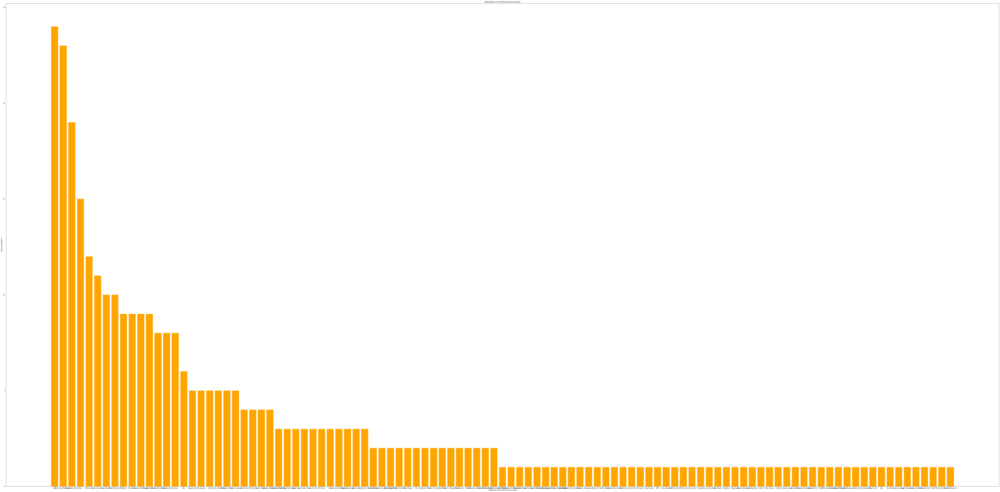

In [61]:
x=cluster_1['1st Most Common Venue'].value_counts().keys().tolist()
y=cluster_1['1st Most Common Venue'].value_counts().tolist()
fig = plt.figure(figsize = (120,60))
plt.bar(x,y,color='orange')
plt.xlabel('Categories of 1st Most Common Venue')
plt.ylabel('Count of categories')
plt.title('Distribution of 1st Most Common Venue')

# Cluster 2

In [64]:
cluster_2=sydney_merged.loc[sydney_merged['Labels'] == 1]

In [65]:
cluster_2

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
1,Abbotsford,2046,-33.850410,151.128460,Café,1.0
4,Alexandria,2015,-33.912370,151.197030,Café,1.0
6,Allambie Heights,2100,-33.765610,151.251590,Café,1.0
9,Annandale,2038,-33.880050,151.171300,Café,1.0
15,Artarmon,2064,-33.808140,151.183800,Café,1.0
21,Audley,2232,-33.897596,151.154571,Café,1.0
23,Avalon,2107,-33.635860,151.328080,Café,1.0
24,Avalon Beach,2107,-33.635860,151.328080,Café,1.0
27,Balgowlah,2093,-33.793820,151.260660,Café,1.0
29,Balmain,2041,-33.856000,151.175870,Café,1.0


In [75]:
print(cluster_2.shape)

(211, 6)


In [78]:
cluster_2['1st Most Common Venue'].value_counts()

Café                  174
Grocery Store           4
Bakery                  4
Pub                     3
Convenience Store       3
Electronics Store       2
Campground              2
Supermarket             1
Platform                1
Sandwich Place          1
Bar                     1
Beach                   1
Lake                    1
Garden Center           1
Diner                   1
Gastropub               1
Golf Course             1
Fish & Chips Shop       1
Indian Restaurant       1
Print Shop              1
Bowling Alley           1
Athletics & Sports      1
Auto Workshop           1
Home Service            1
Boat or Ferry           1
Shopping Plaza          1
Name: 1st Most Common Venue, dtype: int64

#### As it is clearly seen that in cluster 2 total number of suburbs are 211 which is 30% of the total suburbs of Sydney and in these suburbs only 174 suburbs are those suburbs where cafe or coffe shop is the most visited venue which is  82% of cluster 2.

Text(0.5, 1.0, 'Distribution of 1st Most Common Venue')

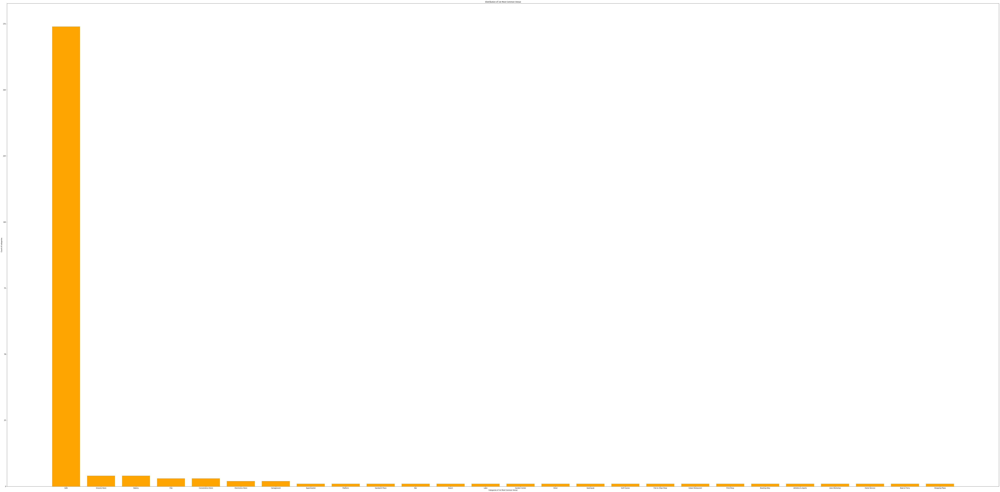

In [66]:
x=cluster_2['1st Most Common Venue'].value_counts().keys().tolist()
y=cluster_2['1st Most Common Venue'].value_counts().tolist()
fig = plt.figure(figsize = (120,60))
plt.bar(x,y,color='orange')
plt.xlabel('Categories of 1st Most Common Venue')
plt.ylabel('Count of categories')
plt.title('Distribution of 1st Most Common Venue')

# Cluster 3

In [68]:
cluster_3=sydney_merged.loc[sydney_merged['Labels'] == 2]

In [69]:
cluster_3

,Neighborhood,Postcode,Latitude,Longitude,1st Most Common Venue,Labels
0,Abbotsbury,2176,-33.872850,150.867210,Convenience Store,2.0
14,Arndell Park,2148,-33.788370,150.879830,Outdoors & Recreation,2.0
22,Austral,2179,-33.926835,150.808311,Park,2.0
28,Balgowlah Heights,2093,-33.804960,151.262050,Park,2.0
39,Bardia,2565,-33.977234,150.861874,Park,2.0
41,Bardwell Valley,2207,-33.937130,151.133050,Park,2.0
48,Beaumont Hills,2155,-33.704980,150.941280,Lake,2.0
76,Blakehurst,2221,-33.987970,151.111490,Sporting Goods Shop,2.0
78,Bligh Park,2756,-33.638631,150.799736,Park,2.0
105,Cabarita,2137,-33.845680,151.115550,Park,2.0


In [76]:
print(cluster_3.shape)

(65, 6)


In [79]:
cluster_3['1st Most Common Venue'].value_counts()

Park                             34
Convenience Store                 3
Café                              3
Lake                              2
Burger Joint                      2
Theme Park                        1
Playground                        1
Grocery Store                     1
Pizza Place                       1
Paper / Office Supplies Store     1
Spa                               1
Tennis Court                      1
Food & Drink Shop                 1
Liquor Store                      1
Sports Club                       1
Pharmacy                          1
Baseball Field                    1
Pet Store                         1
Business Service                  1
Golf Course                       1
Fish & Chips Shop                 1
History Museum                    1
Dessert Shop                      1
Sporting Goods Shop               1
Outdoors & Recreation             1
Supermarket                       1
Name: 1st Most Common Venue, dtype: int64

#### As it is clearly seen that in cluster 3 total number of suburbs are 65 which is 7.4% of the total suburbs of Sydney and in these suburbs only 3 suburbs are those suburbs where cafe or coffe shop is the most visited venue which is 4.6% of cluster 3

Text(0.5, 1.0, 'Distribution of 1st Most Common Venue')

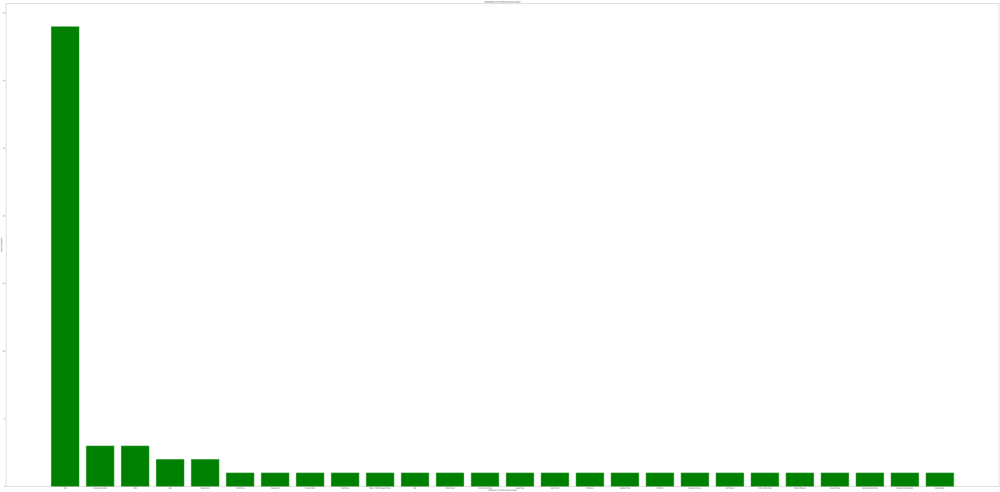

In [71]:
x=cluster_3['1st Most Common Venue'].value_counts().keys().tolist()
y=cluster_3['1st Most Common Venue'].value_counts().tolist()
fig = plt.figure(figsize = (120,60))
plt.bar(x,y,color='Green')
plt.xlabel('Categories of 1st Most Common Venue')
plt.ylabel('Count of categories')
plt.title('Distribution of 1st Most Common Venue')